## Mapping the Terrain of Berlin

Data is taken from the following source:  
https://land.copernicus.eu/imagery-in-situ/eu-dem/eu-dem-v1.1?tab=download

Loading the data with the following:  
https://github.com/cgohlke/tifffile

In [111]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import animation

In [112]:
matplotlib.rcParams['animation.html'] = 'jshtml'

r"C:\Users\lcube\Desktop\project_data\eu_dem_v11_E40N30\eu_dem_v11_E40N30.TIF"

In [76]:
im = tifffile.imread(r"C:\Users\lcube\Desktop\project_data\eu_dem_v11_E40N30\eu_dem_v11_E40N30.TIF")
print(np.shape(im))

(40000, 40000)


A note on coordinates:  
The standard degree system looks to be EPSG:4326.   
In this form, Berlin is at 52°31′12″N 13°24′18″E.   
The source of the data uses the form EPSG:3035.  
Here, Berlin then becomes X: 4552036.45, Y: 3273268.27.  
The city lies on the E40N30 tile, thus the lower left  
point is at 4000km x 3000km from (0,0).
Resolution for the data is 25m.
New points within this tile are then,

In [3]:
res = 25
berlin_x = 4552036.45
berlin_y = 3273268.27
rel_x = 3086656.97
rel_y = -2292253.81
X = int(((berlin_x - 4000*1000)) / res)
Y = int(((berlin_y - 3000*1000)) / res)
print(X,Y)

22081 10930


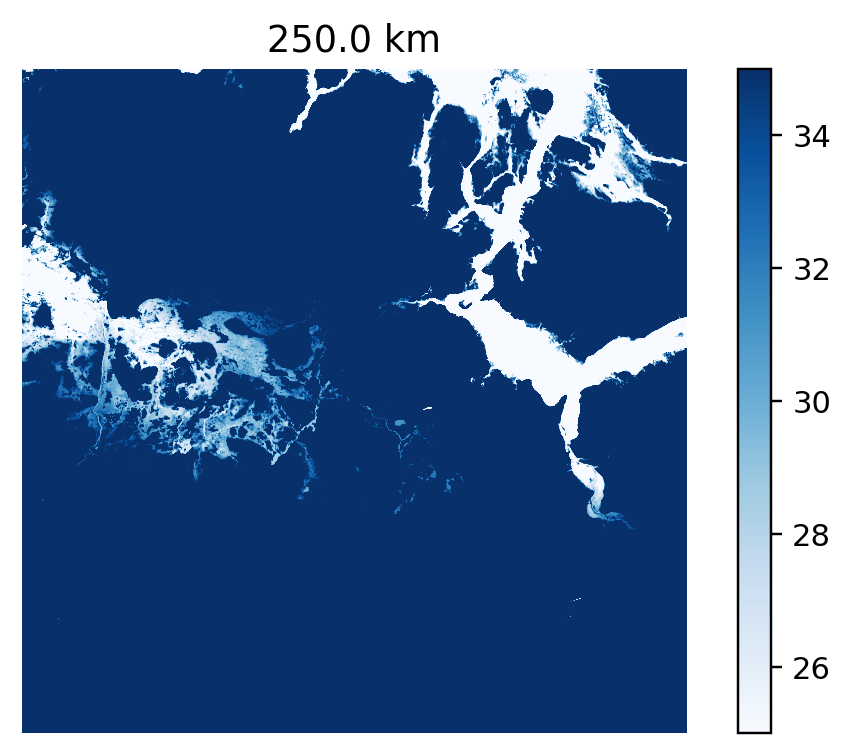

In [66]:
A = 5000
vmin, vmax = 25, 35
plt.figure(dpi=220)
plt.imshow(im[-Y-A:-Y+A,X-A:X+A], cmap='Blues', vmin=vmin, vmax=vmax)
plt.title('{} km'.format(res*A*2 / 1e3))
plt.axis('off')
plt.colorbar()
plt.show()

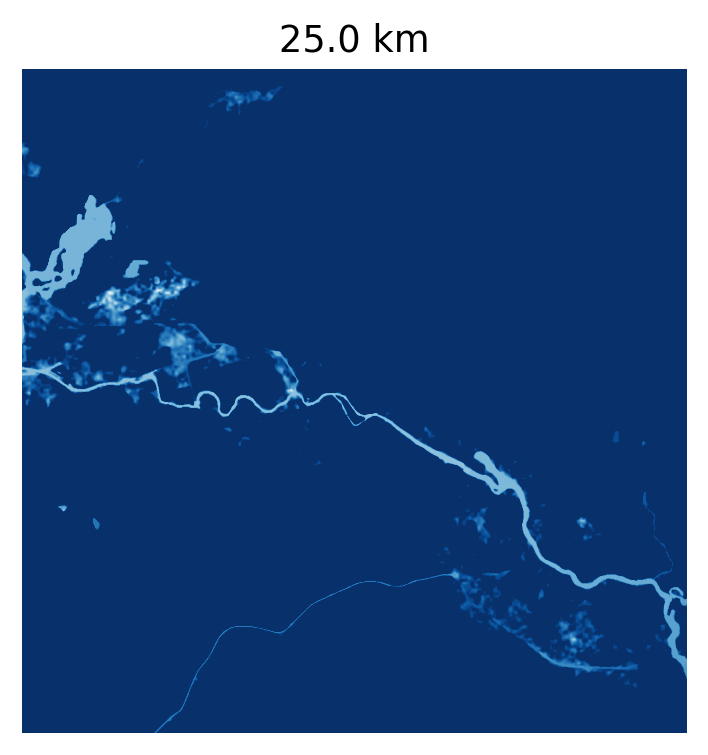

In [100]:
class AnimatedImage(object):
    def __init__(self, frame_num=100):
        self.frame_num = frame_num
        self.fig, self.ax = plt.subplots(dpi=220)
        self.ani = animation.FuncAnimation(self.fig, self.update, interval=5,
                                           init_func=self.setup_plot, blit=True)
    
    def setup_plot(self):
        self.A = 500
        self.vmin = 25
        self.vmax = 35
        self.ani = self.ax.imshow(im[-Y-self.A:-Y+self.A,X-self.A:X+self.A], cmap='Blues', vmin=self.vmin, vmax=self.vmax)
        self.ax.set_title('{} km'.format(res*self.A*2 / 1e3))
        self.ax.axis('off')
        return self.ani,
             
    def update(self, i):
        self.A = 500 * i
        self.ani = self.ax.imshow(im[-Y-self.A:-Y+self.A,X-self.A:X+self.A], cmap='Blues', vmin=self.vmin, vmax=self.vmax)
        return self.ani,
    
AnimatedImage()

In [125]:
frames = 250
vmin, vmax = 25, 35

def update(i):
    A = 25*i
    plt.cla()
    ax.imshow(im[-Y-A:-Y+A,X-A:X+A], cmap='Blues', vmin=vmin, vmax=vmax)
    ax.set_title('{} km'.format(res*A*2 / 1e3))
    ax.axis('off')

%matplotlib agg 
%matplotlib agg
fig = plt.figure(dpi=220)
ax = fig.add_subplot()
ani = animation.FuncAnimation(fig, update, frames, interval=100)
ani

<ipython-input-125-82a396b39592>:7: UserWarning: Attempting to set identical left == right == -0.5 results in singular transformations; automatically expanding.
  ax.imshow(im[-Y-A:-Y+A,X-A:X+A], cmap='Blues', vmin=vmin, vmax=vmax)
<ipython-input-125-82a396b39592>:7: UserWarning: Attempting to set identical bottom == top == -0.5 results in singular transformations; automatically expanding.
  ax.imshow(im[-Y-A:-Y+A,X-A:X+A], cmap='Blues', vmin=vmin, vmax=vmax)
Animation size has reached 21176385 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
